# Import Libraries

In [ ]:
!pip install transformers

In [ ]:
!pip install keras-ocr

In [ ]:
import cv2
import imutils as im
from google.colab.patches import cv2_imshow
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import keras_ocr
import os
import math
import zipfile
import threading
import time

# Removing Folder Util

In [ ]:
%rm -rf PreprocessedTestImages
%rm -rf WarpedTestImages

# Import DataTest

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
test_image_folder = "/content/drive/MyDrive/satriadata/DataTestOriginal"
save_dir = "/content/drive/MyDrive/satriadata"
drive_folder = "/content/drive/MyDrive/satriadata"
base_path = "/content/"

In [ ]:
df_test = pd.read_csv('submission.csv')
df_test1 = pd.read_csv('submission.csv')
df_test

,Unnamed: 0,Name of File,Vehicleregistrationplatebymodel
0,0,DataTest1.png,NaN
1,1,DataTest2.png,NaN
2,2,DataTest3.png,NaN
3,3,DataTest4.png,NaN
4,4,DataTest5.png,NaN
...,...,...,...
95,95,DataTest96.png,NaN
96,96,DataTest97.png,NaN
97,97,DataTest98.png,NaN
98,98,DataTest99.png,NaN


# Keras-OCR Initialization

In [ ]:
recognizer = keras_ocr.recognition.Recognizer()
recognizer.model.load_weights('/content/drive/MyDrive/satriadata/plat1.h5')
pipeline = keras_ocr.pipeline.Pipeline(recognizer=recognizer)

Looking for /root/.keras-ocr/crnn_kurapan.h5
Looking for /root/.keras-ocr/craft_mlt_25k.h5


# Image Enchancement Preprocessing

In [ ]:
def perform_plate_localization(image):
  counter = 0

  # Menggunakan cara closed Contour
  NumberPlateCnt = closed_contour_method(image)

  # Jika cara closed contour tidak dapat mendeteksi
  if NumberPlateCnt.all() == 0:
      # Menggunakan metode morphological operation
      imagen = cv2.bitwise_not(image)
      NumberPlateCnt, thresh = select_license_plate_area(imagen)

  # Proses Transformasi gambar
  ordered_points = arrange_point(NumberPlateCnt)
  warped_images = image_transformation(image, ordered_points)

  # Menghitung sudut maksimum dari gambar
  degree = count_angle(ordered_points)
  epsilon = 1

  # Error Correction untuk gambar miring dengan sudut kecil
  if abs(degree) < 5:
      rotated = im.rotate_bound(warped_images, 2)
  else:
      # Error Correction untuk gambar yang miring
      if degree <= 0:  # Jika sudut negatif (sisi kiri lebih rendah dari sisi kanan)
          rotated = im.rotate_bound(warped_images, -1 * (0.1 * degree) + epsilon)
      else:  # Jika sudut positif (sisi kanan lebih rendah dari sisi kiri)
          rotated = im.rotate_bound(warped_images, 0.05 * degree + epsilon)
  contour_drown = cv2.drawContours(image, [NumberPlateCnt], -1, (255, 0, 0), 2)
  return (contour_drown,warped_images)

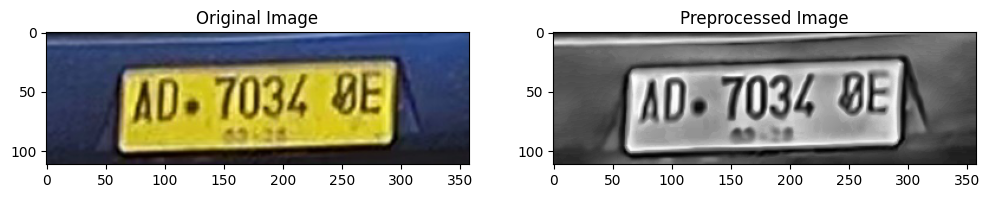

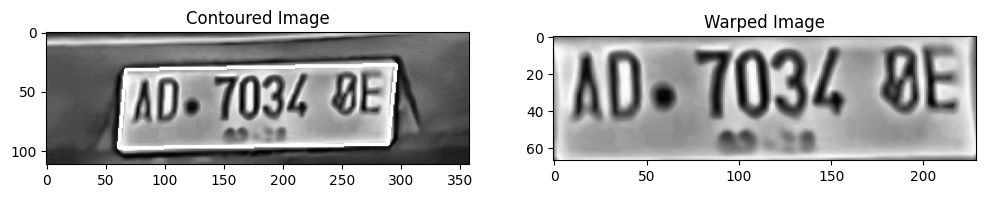

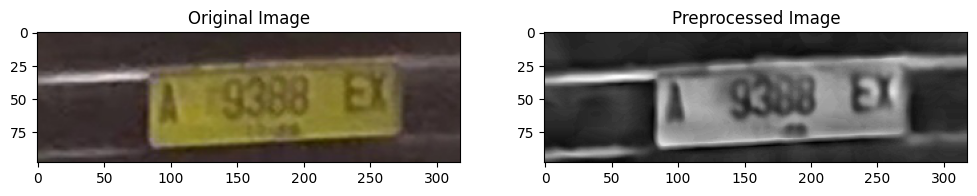

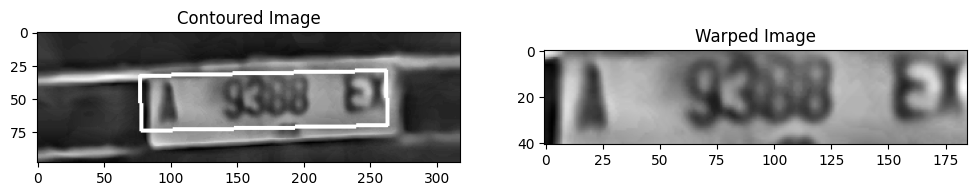

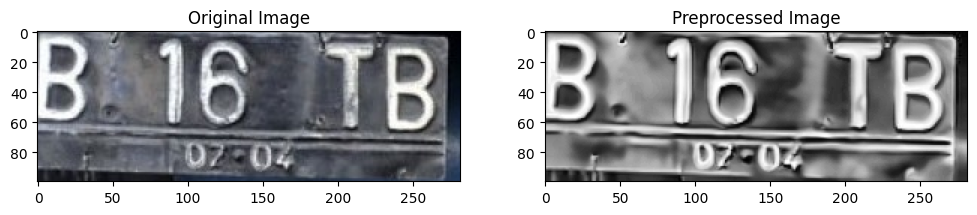

...

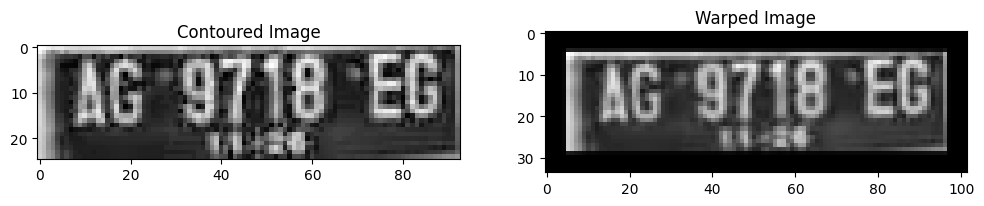

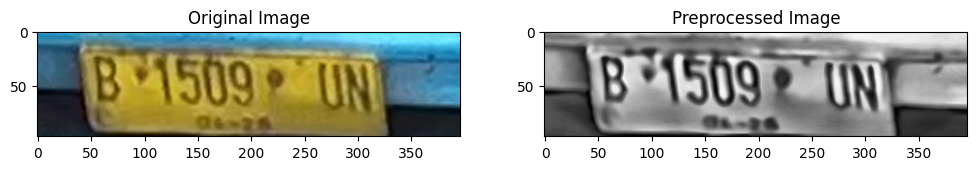

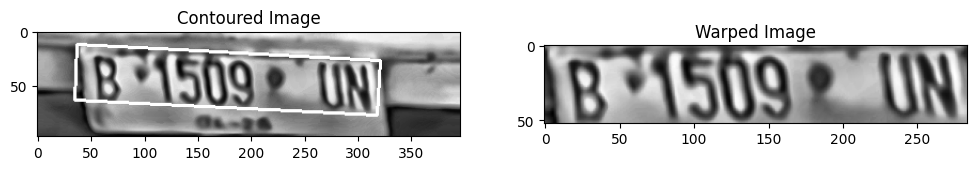

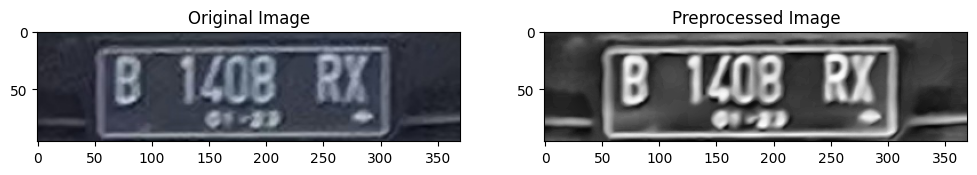

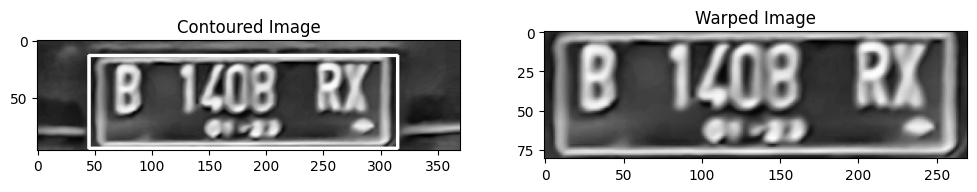

Preprocessing and saving of images complete.
Preprocessed images zipped.


In [ ]:
test_csv_file = 'DataTest.csv'
test_image_folder_original = 'DataTestOriginal'

test_csv_path = os.path.join(base_path, test_csv_file)
test_image_folder_path = os.path.join(base_path, test_image_folder_original)

# Load the CSV file and read the image paths
df_test = pd.read_csv('DataTest.csv')
test_image_paths = df_test['Name of File'].apply(lambda x: os.path.join(test_image_folder_path, x)).values

# Image preprocessing function
def perform_image_preprocessing(image):
    try:
        # Check if the image is None or has invalid data
        if image is None or len(image.shape) < 3:
            raise ValueError("Invalid image format.")

        # Convert image to RGB if it is in BGR format
        if len(image.shape) == 3 and image.shape[2] == 3:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Apply denoising to the image
        denoised_image = cv2.fastNlMeansDenoisingColored(image, None, 10, 10, 7, 21)

        # Normalize image to range [0, 1]
        denoised_image = denoised_image / 255.0

        # Convert image to 8-bit unsigned integer (CV_8U)
        denoised_image = (denoised_image * 255).astype(np.uint8)

        # Convert image to grayscale
        gray = cv2.cvtColor(denoised_image, cv2.COLOR_RGB2GRAY)

        # Apply CLAHE to grayscale image
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
        equalized_image = clahe.apply(gray)

        return equalized_image

    except Exception as e:
        print(f"Error occurred during image preprocessing: {str(e)}")
        return None


# Preprocess and save the images
preprocessed_folder = os.path.join(os.getcwd(), 'PreprocessedTestImages')
os.makedirs(preprocessed_folder, exist_ok=True)
# Warped and save the images
warped_folder = os.path.join(os.getcwd(), 'WarpedTestImages')
os.makedirs(warped_folder, exist_ok=True)

preprocessed_images_list = []
warped_images_list = []

for image_path in test_image_paths:
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.rcParams["figure.figsize"] = [12, 8]  # Customize the width and height as desired

    # Display the original image
    plt.subplot(2, 2, 1)
    plt.imshow(image)
    plt.title('Original Image')

    preprocessed_image = perform_image_preprocessing(image)

    if preprocessed_image is not None:
        preprocessed_image_path = os.path.join(preprocessed_folder, os.path.basename(image_path))
        cv2.imwrite(preprocessed_image_path, preprocessed_image)
        preprocessed_images_list.append(preprocessed_image_path)

        # Display the preprocessed image
        plt.subplot(2, 2, 2)
        plt.imshow(preprocessed_image, cmap='gray')
        plt.title('Preprocessed Image')
        plt.show()

        contour_drawn,warped_images = perform_plate_localization(preprocessed_image)
        warped_image_path = os.path.join(warped_folder, os.path.basename(image_path))
        cv2.imwrite(warped_image_path, warped_images)
        warped_images_list.append(warped_image_path)

        plt.subplot(2, 2, 3)
        plt.imshow(contour_drawn, cmap='gray')
        plt.title('Contoured Image')

        plt.subplot(2, 2, 4)
        plt.imshow(warped_images, cmap='gray')
        plt.title('Warped Image')
        plt.show()
    else:
        print(f"Skipping image {image_path} due to preprocessing error.")

print("Preprocessing and saving of images complete.")

# Create a zip file containing the preprocessed images
zip_file_path = os.path.join(os.getcwd(), 'PreprocessedImages.zip')
with zipfile.ZipFile(zip_file_path, 'w') as zipf:
    for image_path in preprocessed_images_list:
        zipf.write(image_path, os.path.basename(image_path))

# Create a zip file containing the preprocessed images
zip_warped_file_path = os.path.join(os.getcwd(), 'WarpedImages.zip')
with zipfile.ZipFile(zip_warped_file_path, 'w') as zipf:
    for image_path in warped_images_list:
        zipf.write(image_path, os.path.basename(image_path))

print("Preprocessed images zipped.")


# Download ZIP PreprocessedImages and Extract them </br>Place it in your drive in folder named satriadata/DataTest

# Function Definition

In [ ]:
# Function to sort the 4 edges of the plate for consistency
def arrange_point(points):
  # The coordinates will be sorted in the order left-top-right, bottom-right and bottom-left
  coord_rect = np.zeros((4, 2),dtype="float32")

  # The top-left dot will have the smallest number and the bottom-right dot will have the largest amount
  s = points.sum(axis = 1)
  coord_rect[0] = points[np.argmin(s)]
  coord_rect[2] = points[np.argmax(s)]

  # The top-right point will have the smallest reduction result and the bottom-left point will have the largest reduction result
  difference = np.diff(points, axis = 1)
  coord_rect[1] = points[np.argmin(difference)]
  coord_rect[3] = points[np.argmax(difference)]
  return coord_rect

# Function for image transformation by taking pictures in the 4-point area
def image_transformation(image, points):

	(tl, tr, br, bl) = points

  # Calculates the maximum image width
	width_1 = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
	width_2 = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
	max_width = max(int(width_1), int(width_2))

	# Calculates the maximum image height
	height_1 = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
	height_2 = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
	max_height = max(int(height_1), int(height_2))

  # Transform the image by taking 4 points to get a top view of the desired image area
	dst = np.array([
		[0, 0],
		[max_width - 1, 0],
		[max_width - 1, max_height - 1],
		[0, max_height - 1]
  ], dtype = "float32")

	# Calculating the Transformation Matrix
	Matrix = cv2.getPerspectiveTransform(points, dst)
	result = cv2.warpPerspective(image, Matrix, (max_width, max_height))
	return result

# Function to calculate the maximum angle of the horizontal line from the edge of the detected plate
def count_angle(points) :
  upper_left, upper_right, lower_right, lower_left = points

  # Calculates the width and height of a pair of sides
  height_1 = (upper_right[1]-upper_left[1])
  width_1 = (upper_right[0]-upper_left[0])
  height_2 = (lower_right[1]-lower_left[1])
  width_2 = (lower_right[0]-lower_left[0])

  # Finds the maximum angle relative to the horizontal line
  # Positive angle clockwise from the positive x-axis
  degree_1 = math.atan2(height_1,width_1)
  degree_2 = math.atan2(height_2,width_2)

  if degree_1>=0 and degree_2>=0 :
    degree = max(degree_1,degree_2)
  elif degree_1<0 and degree_2>=0 :
    degree = degree_1
  elif degree_1>=0 and degree_2<0 :
    degree = degree_2
  elif degree_1<0 and degree_2<0 :
    degree = -1*(max(abs(degree_1),abs(degree_2)))
  else :
    degree = 0

  # mengubah dari unit radian ke derajat
  phi = math.pi
  degree_unit = (degree/(2*phi)*360)

  #return sudut dalam satuan derajat
  return degree_unit

# Function for localization of vehicle plate candidates
def select_license_plate_area(gray, keep=3):

  # Performs a blackhat morphological operation to bring out dark areas on a bright background
  rectKern = cv2.getStructuringElement(cv2.MORPH_RECT, (13, 5))
  blackhat = cv2.morphologyEx(gray, cv2.MORPH_BLACKHAT, rectKern)

  # Looking for bright areas in the image with close morphological operation
  squareKern = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
  light = cv2.morphologyEx(gray, cv2.MORPH_CLOSE, squareKern)
  # light = cv2.cvtColor(light, cv2.COLOR_BGR2GRAY)
  light = cv2.threshold(light, 0, 255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]

  # Sharpen the gradient edge features with the scharr method on the x axis
  # Then returns the range of pixel values ​​to [0.255]
  gradX = cv2.Sobel(blackhat, ddepth=cv2.CV_32F,
  dx=1, dy=0, ksize=-1)
  gradX = np.absolute(gradX)
  (minVal, maxVal) = (np.min(gradX), np.max(gradX))
  gradX = 255 * ((gradX - minVal) / (maxVal - minVal))
  gradX = gradX.astype("uint8")

  # Perform a gaussian blur on the image then perform a closing morphological operation and then perform tresholding using the otsu method
  gradX = cv2.GaussianBlur(gradX, (5, 5), 0)
  gradX = cv2.morphologyEx(gradX, cv2.MORPH_CLOSE, rectKern)
  # gradX = cv2.cvtColor(gradX, cv2.COLOR_BGR2GRAY)
  thresh = cv2.threshold(gradX, 0, 255,
		cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]

  # Perform erode and dilate operations to remove noise outside of significant objects
  thresh = cv2.erode(thresh, None, iterations=3)
  thresh = cv2.dilate(thresh, None, iterations=3)

  # Masking with the light image from the previous function to focus the image on the bright part (where the plate is located)
  # Then perform dilate and erode operations to remove noise in significant objects
  thresh = cv2.bitwise_and(thresh, thresh, mask=light)
  thresh = cv2.dilate(thresh, None, iterations=5)
  thresh = cv2.erode(thresh, None, iterations=5)

  # Search for closed contours of the image
  cnts,hir = cv2.findContours(thresh.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
  cnts=sorted(cnts, key = cv2.contourArea, reverse = True)

  # Template for masking
  mask = np.ones(image.shape[:2], dtype="uint8") * 255

  if len(cnts) >= 4 :
    cv2.drawContours(mask, cnts[4:], -1, 0, -1)
  thresh = cv2.bitwise_and(thresh, thresh, mask=mask)

  # Masking for contours that have a smaller size compared to the main object contour
  for c in cnts :
    if cv2.arcLength(c,True) < 0.25*cv2.arcLength(cnts[0],True) :
      cv2.drawContours(mask, [c], -1, 0, -1)
  thresh = cv2.bitwise_and(thresh, thresh, mask=mask)

  cnts,hir = cv2.findContours(thresh.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
  cnts=sorted(cnts, key = cv2.contourArea, reverse = True)

  # Make a boundary box of all objects that are estimated as vehicle plates in binary images
  points = cv2.findNonZero(thresh)
  xandy, dimension, degree = cv2.minAreaRect(points)
  dimension = list(dimension)
  dimension[0] = 1*dimension[0]+10
  dimension[1] = 1*dimension[1]+10
  rect = []
  rect.append(xandy)
  rect.append(dimension)
  rect.append(degree)
  rect = tuple(rect)

  # Variable to store the coordinates of 4 corner points from the bounding box prediction for vehicle plates
  box = cv2.boxPoints(rect)
  box = np.int0(box)

  # return coordinates and localized images
  return box,thresh

# Algorithm for searching 4 corner points of license plate localization
def closed_contour_method(image) :
  gray = image

  # Removing Noise using Gaussian Blur
  denoised_img = cv2.GaussianBlur(gray,(5,5),0)

  # Searching for edges of image using Canny
  lower, upper = 50, 150
  edged = cv2.Canny(denoised_img, lower, upper)

  # Looking for closed contours from the image then sorted from the largest
  contours,hir = cv2.findContours(edged.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
  contours=sorted(contours, key = cv2.contourArea, reverse = True)[:10]
  NumberPlateCnt = np.zeros((4,2))

  # Look for contours that have potential as plate objects
  count = 0
  for contour in contours:
        peri = cv2.arcLength(contour, True)
        # Approximate potential contour length
        epsilon = 0.01 * peri
        approx = cv2.approxPolyDP(contour, epsilon, True)

        # Selecting a contour with 4 points (quadrilateral)
        if len(approx) == 4  :
            NumberPlateCnt = approx
            NumberPlateCnt = NumberPlateCnt.reshape(4,2)
            count += 1
            break
  return NumberPlateCnt

# Perform Plate Detection

In [ ]:
df_test1

,Unnamed: 0,Name of File,Vehicleregistrationplatebymodel
0,0,DataTest1.png,
1,1,DataTest2.png,
2,2,DataTest3.png,
3,3,DataTest4.png,
4,4,DataTest5.png,
5,5,DataTest6.png,
6,6,DataTest7.png,
7,7,DataTest8.png,
8,8,DataTest9.png,
9,9,DataTest10.png,


# Perform Detection without Adjustment

1/1 [==============================] - 1s 741ms/step


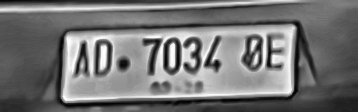

['OI', '7034', 'AD']

1/1 [==============================] - 0s 291ms/step


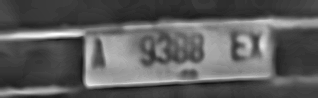

['1K2']

1/1 [==============================] - 1s 1s/step


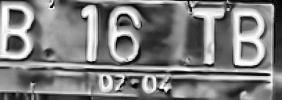

['B', '16', 'TB']

1/1 [==============================] - 1s 1s/step


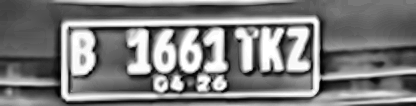

['DKZ', '1551', 'B']

1/1 [==============================] - 0s 287ms/step


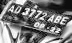

['2227248ER']

1/1 [==============================] - 0s 294ms/step


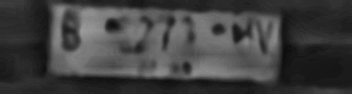

['I']

1/1 [==============================] - 1s 766ms/step


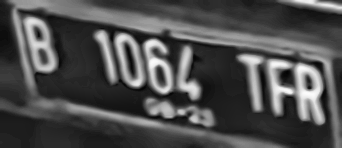

['B', 'NSSL', 'TFP']

1/1 [==============================] - 1s 1s/step


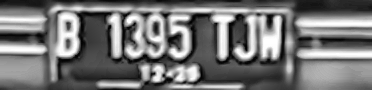

['B', '1395', 'TJW']

1/1 [==============================] - 1s 719ms/step


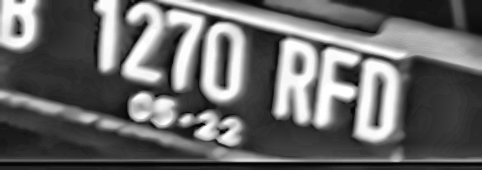

['', '1270', 'RFD']

1/1 [==============================] - 1s 755ms/step


['B', '1736', 'BYH']

1/1 [==============================] - 0s 123ms/step


['Not Detected']

1/1 [==============================] - 1s 725ms/step


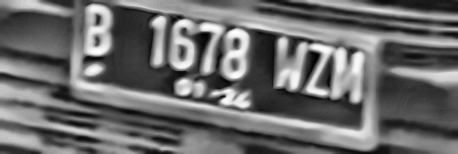

['P', '1678', 'WITM']

1/1 [==============================] - 2s 2s/step


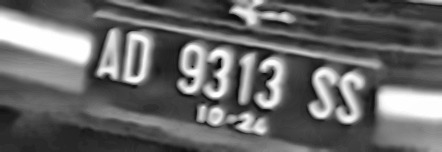

['AD', '9313', 'SS']

1/1 [==============================] - 1s 528ms/step


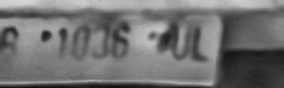

['166', '']

1/1 [==============================] - 1s 724ms/step


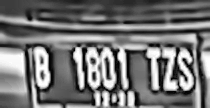

['1801', 'B', 'TZS']

1/1 [==============================] - 1s 722ms/step


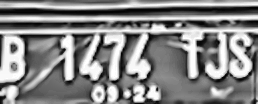

['1474', 'TJS', 'B']

1/1 [==============================] - 1s 960ms/step


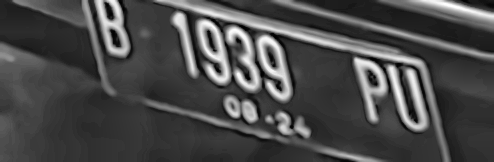

['B', 'NSSS', 'PS']

1/1 [==============================] - 1s 731ms/step


['1260', 'IB', 'TLI']

1/1 [==============================] - 1s 957ms/step


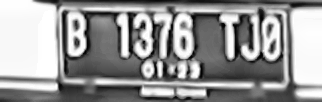

['1376', 'B', 'TJO']

1/1 [==============================] - 1s 937ms/step


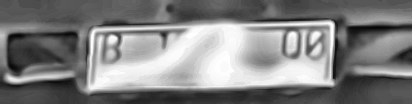

['OI', 'LLM']

1/1 [==============================] - 0s 499ms/step


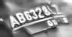

['8620']

1/1 [==============================] - 0s 429ms/step


['82126P26']

1/1 [==============================] - 1s 727ms/step


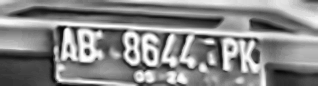

['AB', '8642', 'PK']

1/1 [==============================] - 1s 737ms/step


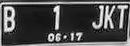

['JKT', 'B', '0G8174']

1/1 [==============================] - 1s 723ms/step


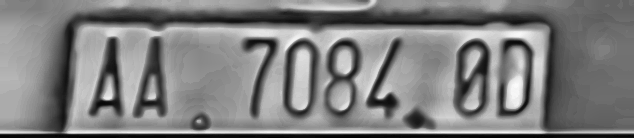

['7084', 'AA', 'OD']

1/1 [==============================] - 1s 1s/step


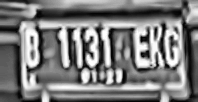

['EKG', '1310', '6']

1/1 [==============================] - 0s 261ms/step


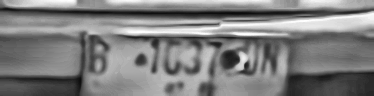

['113']

1/1 [==============================] - 1s 717ms/step


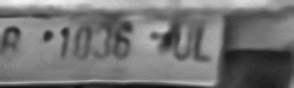

['1136', '', 'I']

1/1 [==============================] - 0s 284ms/step


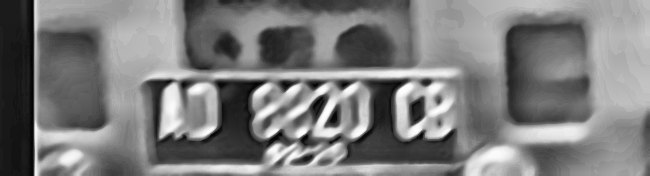

['CO']

1/1 [==============================] - 1s 955ms/step


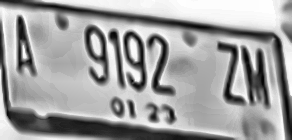

['N', '9GL', 'AN']

1/1 [==============================] - 1s 513ms/step


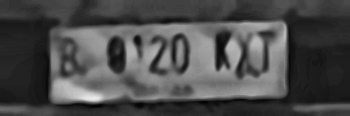

['ON20', 'A']

1/1 [==============================] - 2s 2s/step


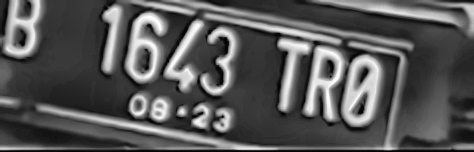

['6B', '1643', 'TRO']

1/1 [==============================] - 1s 747ms/step


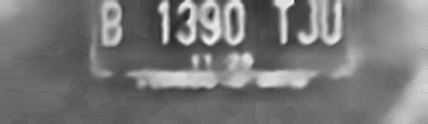

['TJU', '1390', 'B']

1/1 [==============================] - 1s 988ms/step


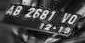

['O', '268', '222']

1/1 [==============================] - 2s 2s/step


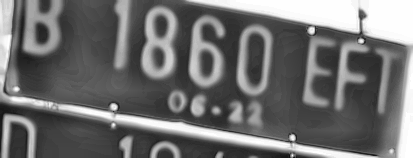

['D', '1860', 'EFT']

1/1 [==============================] - 1s 752ms/step


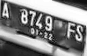

['A', '8749', 'FS']

1/1 [==============================] - 1s 737ms/step


['B', '1566', 'FON']

1/1 [==============================] - 1s 736ms/step


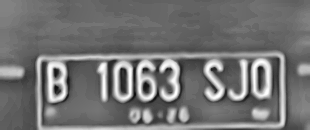

['1063', 'SJQ', 'B']

1/1 [==============================] - 2s 2s/step


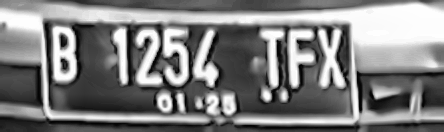

['B', '1254', 'TFX']

1/1 [==============================] - 0s 86ms/step


['Not Detected']

1/1 [==============================] - 1s 1s/step


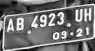

['UH', '4923', 'AB']

1/1 [==============================] - 1s 883ms/step


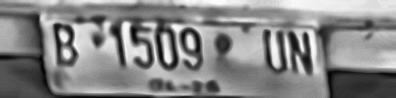

['B1509', 'UNI']

1/1 [==============================] - 1s 1s/step


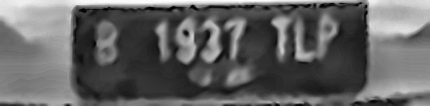

['TLP', '1937', 'B']

1/1 [==============================] - 1s 733ms/step


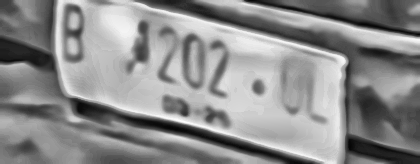

['B', 'AYI', '']

1/1 [==============================] - 1s 742ms/step


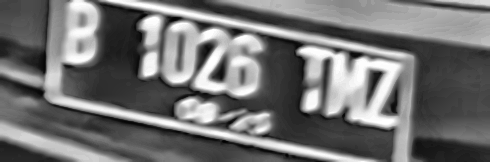

['P', '1026', 'MMDZ']

1/1 [==============================] - 1s 963ms/step


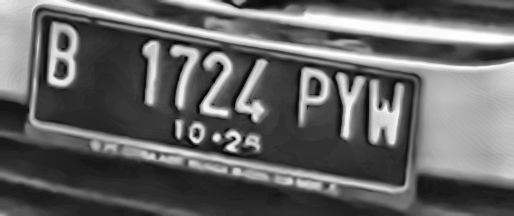

['B', '1724', 'PYW']

1/1 [==============================] - 1s 729ms/step


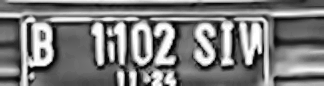

['SIO', '1102', 'B']

1/1 [==============================] - 1s 752ms/step


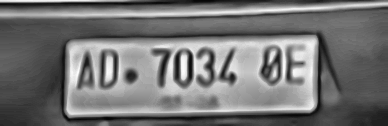

['OE', 'AD', '7034']

1/1 [==============================] - 2s 2s/step


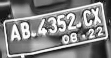

['CX', 'A843521', '25']

1/1 [==============================] - 1s 990ms/step


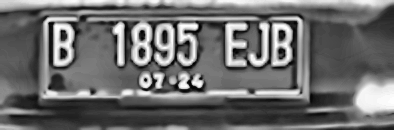

['1895', 'EUB', 'B']

1/1 [==============================] - 1s 741ms/step


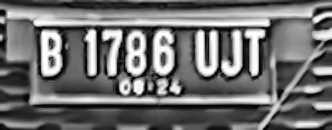

['1786', 'UJT', 'B']

1/1 [==============================] - 1s 1s/step


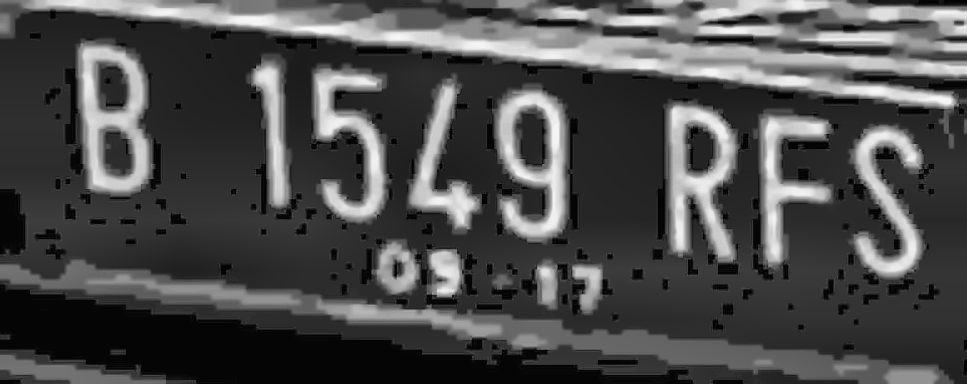

['B', '15L9', 'RFS']

1/1 [==============================] - 1s 731ms/step


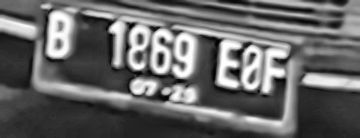

['B', '1869', 'EOF']

1/1 [==============================] - 1s 1s/step


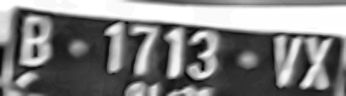

['B', '1713', 'WX']

1/1 [==============================] - 2s 2s/step


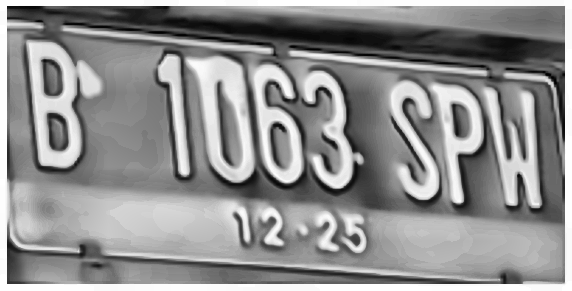

['B', '1663', 'SPB']

1/1 [==============================] - 1s 959ms/step


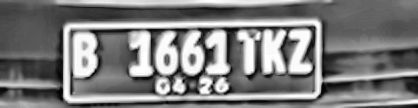

['2551KZ', 'B', 'K001']

1/1 [==============================] - 1s 510ms/step


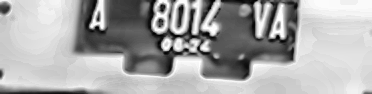

['8014', 'VA']

1/1 [==============================] - 1s 705ms/step


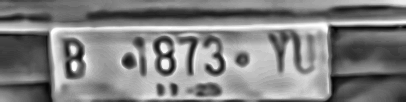

['L', '48734', 'B']

1/1 [==============================] - 2s 2s/step


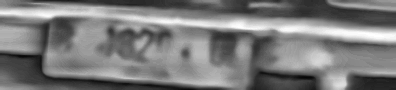

['Not Detected']

1/1 [==============================] - 1s 763ms/step


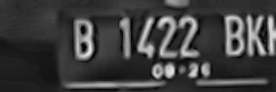

['BK', '1422', 'B']

1/1 [==============================] - 1s 1s/step


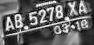

['XB', '5278', 'AB']

1/1 [==============================] - 1s 1s/step


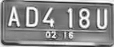

['AD4', '18U', '92']

1/1 [==============================] - 2s 2s/step


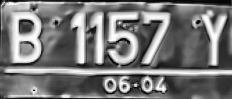

['1157', 'Y', 'B']

1/1 [==============================] - 1s 719ms/step


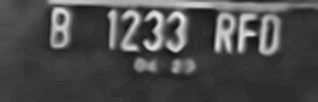

['1233', 'B', 'RFD']

1/1 [==============================] - 1s 503ms/step


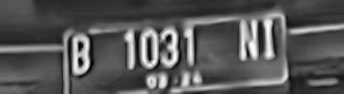

['1031', 'B']

1/1 [==============================] - 1s 724ms/step


['AD', '99', 'JR']

1/1 [==============================] - 1s 517ms/step


['1683', 'SEY']

1/1 [==============================] - 0s 477ms/step


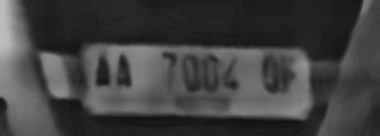

['NT']

1/1 [==============================] - 1s 733ms/step


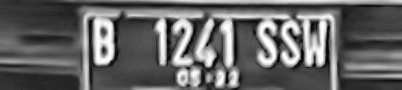

['1241', 'SSW', 'B']

1/1 [==============================] - 1s 724ms/step


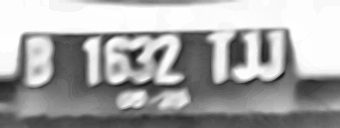

['111', 'B', '1632']

1/1 [==============================] - 1s 735ms/step


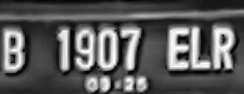

['1907', 'ELR', 'B']

1/1 [==============================] - 1s 1s/step


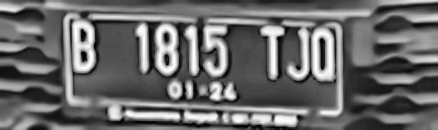

['B', '1815', 'TJQ']

1/1 [==============================] - 1s 733ms/step


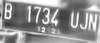

['B', '1734', 'UJN']

1/1 [==============================] - 2s 2s/step


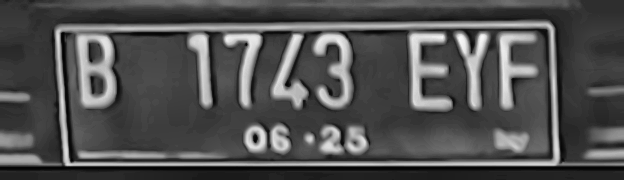

['EYF', '1743', 'B']

1/1 [==============================] - 1s 761ms/step


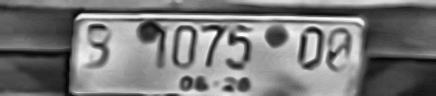

['075', 'G', 'UO']

1/1 [==============================] - 1s 525ms/step


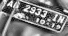

['2933', 'C0']

1/1 [==============================] - 1s 730ms/step


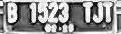

['TJF', 'B', '1523']

1/1 [==============================] - 1s 545ms/step


['1152', 'B']

1/1 [==============================] - 1s 742ms/step


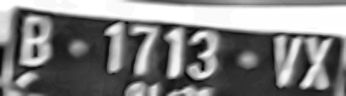

['B', '1713', 'WX']

1/1 [==============================] - 0s 284ms/step


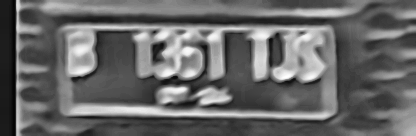

['051T05']

1/1 [==============================] - 0s 272ms/step


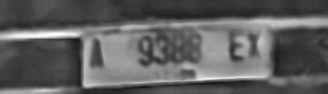

['1K21']

1/1 [==============================] - 1s 716ms/step


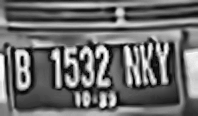

['NKY', '1532', 'IB']

1/1 [==============================] - 1s 545ms/step


['800', 'UYG']

1/1 [==============================] - 0s 494ms/step


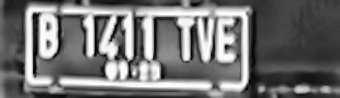

['B', 'TVE']

1/1 [==============================] - 1s 1s/step


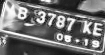

['B', '3787KE', '95']

1/1 [==============================] - 0s 229ms/step


['Not Detected']

1/1 [==============================] - 2s 2s/step


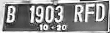

['RFD', '1903', 'B']

1/1 [==============================] - 1s 1s/step


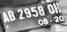

['SN', '2958', 'DO']

1/1 [==============================] - 1s 983ms/step


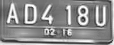

['AD4', '18U', 'C02']

1/1 [==============================] - 1s 964ms/step


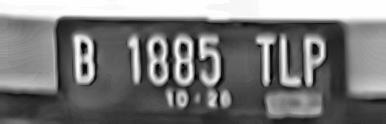

['1885', 'TLP', 'B']

1/1 [==============================] - 1s 768ms/step


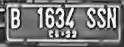

['SSN', '1B', '1634']

1/1 [==============================] - 2s 2s/step


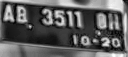

['AB', '3511', 'OI']

1/1 [==============================] - 1s 501ms/step


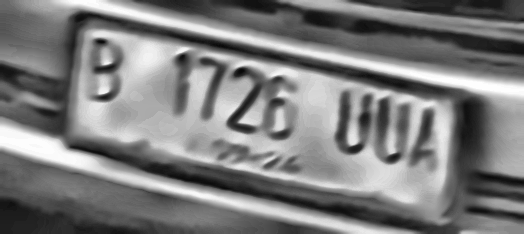

['1726', 'UTA']

1/1 [==============================] - 2s 2s/step


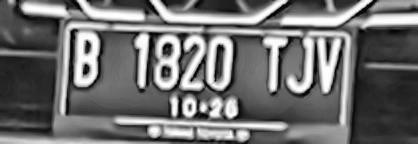

['B', '1820', 'TJN']

1/1 [==============================] - 1s 743ms/step


['19619', 'URB', 'B']

1/1 [==============================] - 2s 2s/step


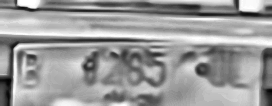

['Not Detected']

1/1 [==============================] - 1s 1s/step


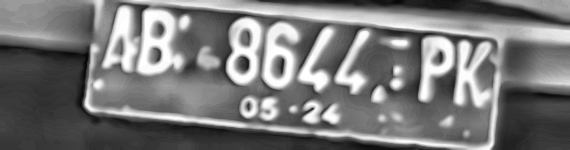

['AB', '8644I', 'PK']

1/1 [==============================] - 1s 827ms/step


['9718', 'EG', 'AG']

1/1 [==============================] - 1s 502ms/step


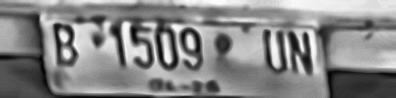

['B1509', 'UNI']

1/1 [==============================] - 1s 748ms/step


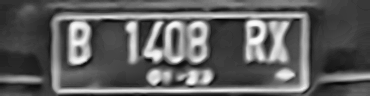

['1408', 'RX', 'B']



In [ ]:
# List untuk menyimpan gambar
plat_2 = []

# List menyimpan gambar dan nama file
images = []
filenames = []

# Kode utama
filenames = os.listdir(test_image_folder)

filenames.sort(key=lambda x: int(x.replace('DataTest', '').replace('.png', '')))

for filename in filenames :
  image = cv2.imread(os.path.join(test_image_folder, filename))

  # Menampilkan data hasil pembacaan Keras-OCR
  data = [image]
  temp = []

  predictions = pipeline.recognize(data)
  for image, prediction in zip(data, predictions) :
    for data in prediction :
      temp.append(data[0].upper())

  if temp == [] :
    temp.append("Not Detected")

  # Menampilkan 3 kata pertama yang terdeteksi
  temp = temp[:3]
  cv2_imshow(image)
  print(temp)
  print()

  # Menyimpan hasil ke list
  list_to_string = " ".join(temp)
  plat_2.append(list_to_string)
df_test['Vehicleregistrationplatebymodel'] = plat_2

In [ ]:
pd.set_option('display.max_rows', None)
df_test

,Unnamed: 0,Name of File,Vehicleregistrationplatebymodel
0,0,DataTest1.png,OI 7034 AD
1,1,DataTest2.png,1K2
2,2,DataTest3.png,B 16 TB
3,3,DataTest4.png,DKZ 1551 B
4,4,DataTest5.png,2227248ER
5,5,DataTest6.png,I
6,6,DataTest7.png,B NSSL TFP
7,7,DataTest8.png,B 1395 TJW
8,8,DataTest9.png,1270 RFD
9,9,DataTest10.png,B 1736 BYH


# Save Dataframe Result to zip

In [ ]:
# Save the DataFrame to a CSV file
csv_filename = 'submissio_wo_correction.csv'
csv_filename1 = 'submission_w_correction.csv'
df_test.to_csv(csv_filename, index=False)
df_test1.to_csv(csv_filename1, index=False)

# Create a zip file containing the CSV file
zip_filename = 'submission.zip'
with zipfile.ZipFile(zip_filename, 'w') as zipf:
    zipf.write(csv_filename)
    zipf.write(csv_filename1)

os.remove(csv_filename)
os.remove(csv_filename1)
print(f"DataFrame ready to downloaded.")